In [3]:
import polars as pl
import pandas as pd
import numpy as np

In [8]:
df = pl.read_parquet(r"C:\try_angle\features\parquet_shards\chunk_000.parquet")
print(df.shape)

(500, 3)


In [9]:
print(df.columns)

['filename', 'midas_mean', 'midas_std']


In [11]:
import numpy as np
import glob

files = sorted(glob.glob(r"C:\try_angle\features\npz_shards\*.npz"))
print(files[:3])

d = np.load(files[0])
print(d.keys())
for k in d.keys():
    print(k, d[k].shape)

['C:\\try_angle\\features\\npz_shards\\chunk_000.npz', 'C:\\try_angle\\features\\npz_shards\\chunk_001.npz', 'C:\\try_angle\\features\\npz_shards\\chunk_002.npz']
KeysView(NpzFile 'C:\\try_angle\\features\\npz_shards\\chunk_000.npz' with keys: clip_emb, dino_emb, filenames)
clip_emb (500, 512)
dino_emb (500, 526080)
filenames (500,)


📂 데이터 로드 중...
(2687, 899)
✅ feature shape: (2687, 896)
🔍 t-SNE 변환 중... (2D 시각화)


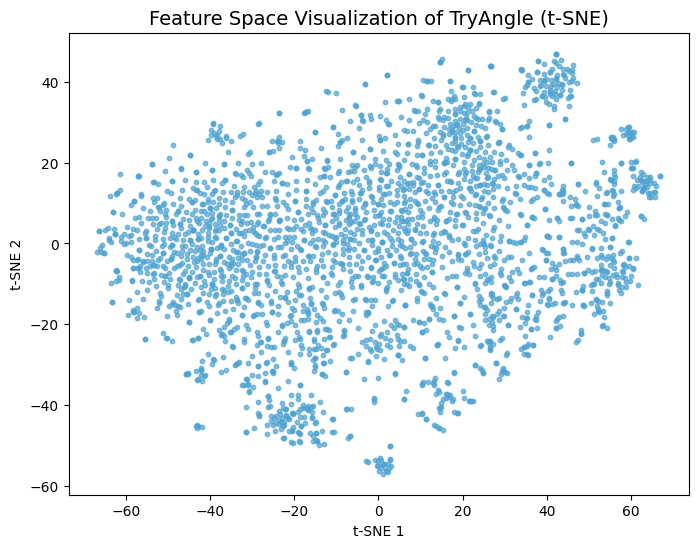

In [14]:
# ============================================================
# 🎨 TryAngle Feature Visualization (UMAP / t-SNE)
# fusion_final.parquet 기반 구도·감성 분포 시각화
# ============================================================

import polars as pl
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler

# ---- 경로 설정 ----
FILE_PATH = r"C:\try_angle\features\fusion_final.parquet"

# ---- 데이터 로드 ----
print("📂 데이터 로드 중...")
df = pl.read_parquet(FILE_PATH)
print(df.shape)

# ---- feature 분리 ----
# filename, midas_mean/std 제외하고 전부 feature로 사용
feature_cols = [c for c in df.columns if not c.startswith("filename") and not c.startswith("midas_")]
X = df.select(feature_cols).to_numpy()
print(f"✅ feature shape: {X.shape}")

# ---- 스케일링 (정규화)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# ---- 차원 축소 (t-SNE 또는 UMAP)
print("🔍 t-SNE 변환 중... (2D 시각화)")
tsne = TSNE(n_components=2, perplexity=40, learning_rate=200, random_state=42)
X_emb = tsne.fit_transform(X_scaled)

# ---- 결과 시각화
plt.figure(figsize=(8, 6))
plt.scatter(X_emb[:,0], X_emb[:,1], s=10, alpha=0.7, color="#4fa3d1")
plt.title("Feature Space Visualization of TryAngle (t-SNE)", fontsize=14)
plt.xlabel("t-SNE 1")
plt.ylabel("t-SNE 2")
plt.show()


📂 데이터 로드 중...
(2687, 899)
✅ feature shape: (2687, 896)
🔍 t-SNE 변환 중... (2D 시각화)
🤖 KMeans 군집화 (k=6) 중...


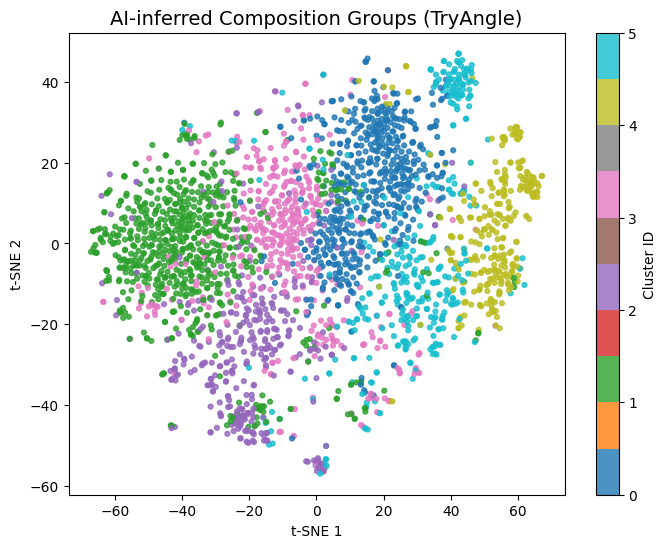

In [15]:
# ============================================================
# 🎨 TryAngle Clustering (KMeans + t-SNE)
# fusion_final.parquet 기반 구도 그룹 시각화
# ============================================================

import polars as pl
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans

# ---- 경로 설정 ----
FILE_PATH = r"C:\try_angle\features\fusion_final.parquet"

# ---- 데이터 로드 ----
print("📂 데이터 로드 중...")
df = pl.read_parquet(FILE_PATH)
print(df.shape)

# ---- feature 선택 (filename, midas 제외)
feature_cols = [c for c in df.columns if not c.startswith("filename") and not c.startswith("midas_")]
X = df.select(feature_cols).to_numpy()
print(f"✅ feature shape: {X.shape}")

# ---- 스케일링
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# ---- 차원 축소 (t-SNE)
print("🔍 t-SNE 변환 중... (2D 시각화)")
tsne = TSNE(n_components=2, perplexity=40, learning_rate=200, random_state=42)
X_emb = tsne.fit_transform(X_scaled)

# ---- 군집화 (KMeans)
n_clusters = 6   # 군집 개수는 5~8 정도에서 조정 가능
print(f"🤖 KMeans 군집화 (k={n_clusters}) 중...")
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
clusters = kmeans.fit_predict(X_scaled)

# ---- 시각화
plt.figure(figsize=(8, 6))
plt.scatter(X_emb[:,0], X_emb[:,1], c=clusters, cmap="tab10", s=12, alpha=0.8)
plt.title("AI-inferred Composition Groups (TryAngle)", fontsize=14)
plt.xlabel("t-SNE 1")
plt.ylabel("t-SNE 2")
plt.colorbar(label="Cluster ID")
plt.show()


📂 데이터 로드 중...
(2687, 899)

🎨 Cluster 0 (표본 5장 중 5장):


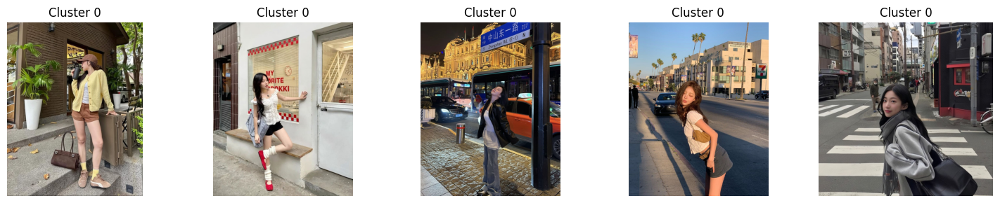


🎨 Cluster 1 (표본 5장 중 5장):


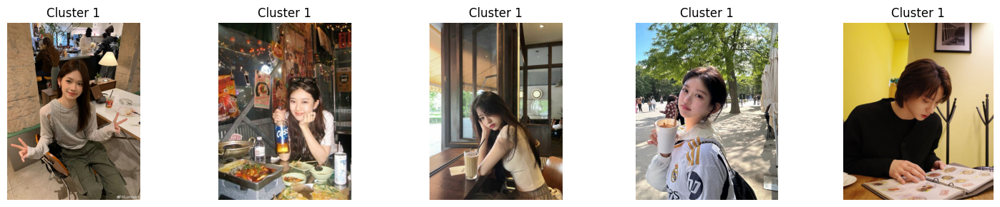


🎨 Cluster 2 (표본 5장 중 5장):


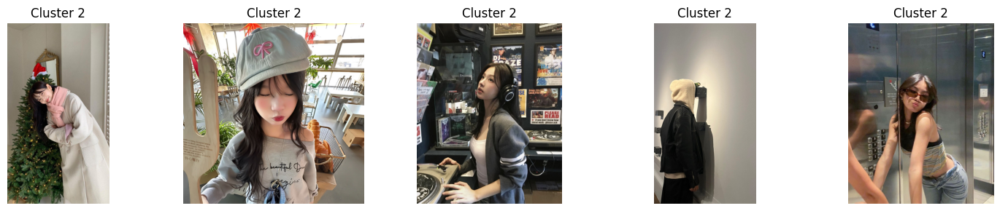


🎨 Cluster 3 (표본 5장 중 5장):


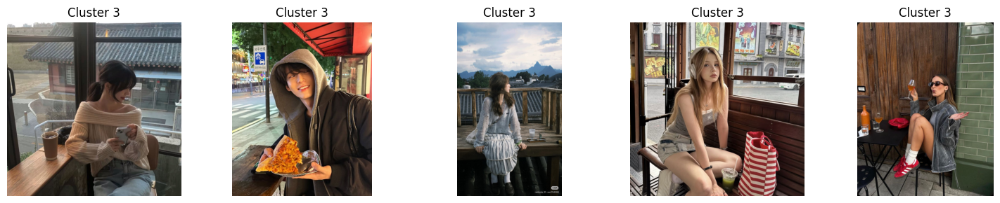


🎨 Cluster 4 (표본 5장 중 5장):


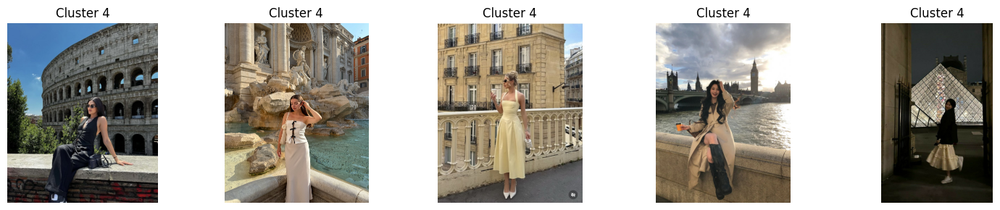


🎨 Cluster 5 (표본 5장 중 5장):


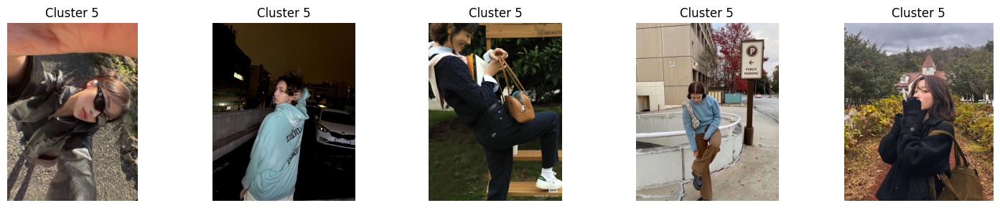

In [16]:
# ============================================================
# 📸 TryAngle Cluster 대표 이미지 시각화
# ============================================================

import polars as pl
import numpy as np
import matplotlib.pyplot as plt
import os
import random
import cv2
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# ---- 경로 설정 ----
FILE_PATH = r"C:\try_angle\features\fusion_final.parquet"
IMG_DIR = r"C:\try_angle\data\train_images"   # 원본 이미지 폴더

# ---- 데이터 로드 ----
print("📂 데이터 로드 중...")
df = pl.read_parquet(FILE_PATH)
print(df.shape)

# ---- feature 선택 (filename, midas 제외)
feature_cols = [c for c in df.columns if not c.startswith("filename") and not c.startswith("midas_")]
X = df.select(feature_cols).to_numpy()

# ---- 스케일링 & KMeans (같은 파라미터로)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
n_clusters = 6
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
clusters = kmeans.fit_predict(X_scaled)

# ---- cluster 결과 추가
df = df.with_columns(pl.Series("cluster", clusters))

# ---- 각 cluster별 대표 이미지 뽑기 ----
os.makedirs(os.path.join(IMG_DIR, "cluster_samples"), exist_ok=True)

for c in range(n_clusters):
    cluster_df = df.filter(pl.col("cluster") == c)
    sample_files = random.sample(list(cluster_df["filename"]), min(5, len(cluster_df)))
    print(f"\n🎨 Cluster {c} (표본 {len(sample_files)}장 중 5장):")

    plt.figure(figsize=(15, 3))
    for i, fname in enumerate(sample_files):
        fpath = os.path.join(IMG_DIR, os.path.basename(fname))
        if not os.path.exists(fpath):
            print(f"⚠️ 이미지 없음: {fpath}")
            continue

        img = cv2.imread(fpath)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.subplot(1, 5, i+1)
        plt.imshow(img)
        plt.axis("off")
        plt.title(f"Cluster {c}")
    plt.tight_layout()
    plt.show()


In [18]:
import matplotlib.pyplot as plt
from matplotlib import font_manager, rc
import matplotlib

# ✅ 윈도우용 (나눔고딕 설치되어 있을 확률 높음)
font_path = "C:/Windows/Fonts/malgun.ttf"  # 또는 "NanumGothic.ttf"

# 폰트 등록
font_name = font_manager.FontProperties(fname=font_path).get_name()
rc('font', family=font_name)

# 마이너스 깨짐 방지
matplotlib.rcParams['axes.unicode_minus'] = False

print(f"✅ Matplotlib 한글 폰트 설정 완료: {font_name}")


✅ Matplotlib 한글 폰트 설정 완료: Malgun Gothic


📂 데이터 로드 중...
(2687, 899)

🎨 [1/3] CLIP feature 기반 군집화


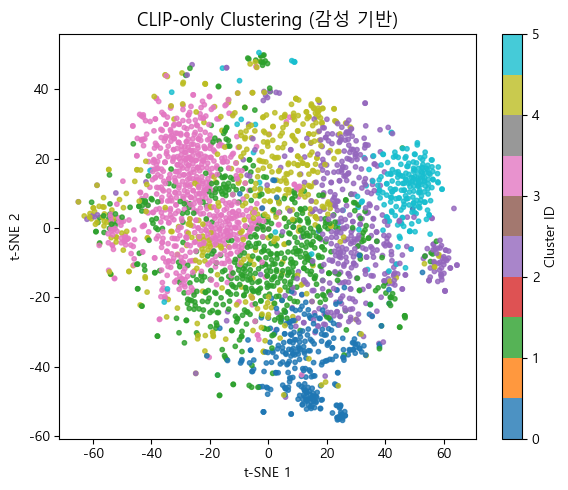


🧩 [2/3] DINO feature 기반 군집화


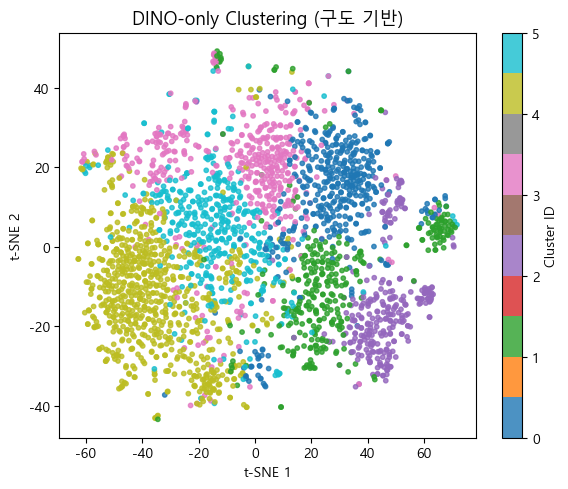


📐 [3/3] MiDaS feature 기반 군집화


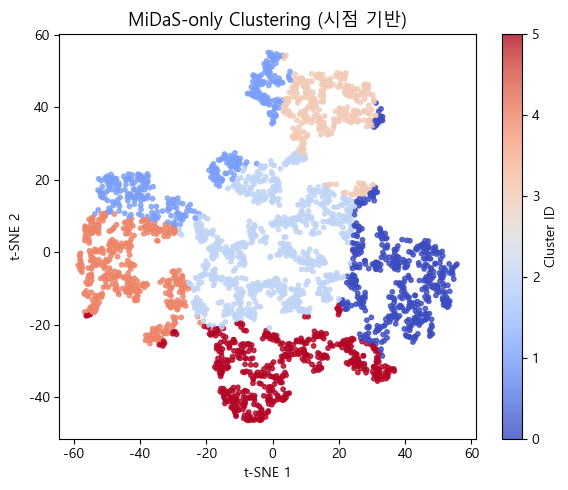

In [19]:
# ============================================================
# 🎨 TryAngle Cluster Comparison: CLIP vs DINO vs MiDaS
# ============================================================

import polars as pl
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans

# ---- 경로 설정 ----
FILE_PATH = r"C:\try_angle\features\fusion_final.parquet"

# ---- 데이터 로드 ----
print("📂 데이터 로드 중...")
df = pl.read_parquet(FILE_PATH)
print(df.shape)

# ---- feature 구분 ----
clip_cols = [c for c in df.columns if c.startswith("clip_")]
dino_cols = [c for c in df.columns if c.startswith("dino_")]
midas_cols = [c for c in df.columns if c.startswith("midas_")]

# ---- 공통 설정 ----
n_clusters = 6
tsne = TSNE(n_components=2, perplexity=40, learning_rate=200, random_state=42)

def cluster_and_plot(X, title, cmap="tab10"):
    # 스케일링
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # 차원 축소
    X_emb = tsne.fit_transform(X_scaled)

    # 군집화
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    clusters = kmeans.fit_predict(X_scaled)

    # 시각화
    plt.figure(figsize=(6,5))
    plt.scatter(X_emb[:,0], X_emb[:,1], c=clusters, cmap=cmap, s=10, alpha=0.8)
    plt.title(title, fontsize=13)
    plt.xlabel("t-SNE 1"); plt.ylabel("t-SNE 2")
    plt.colorbar(label="Cluster ID")
    plt.tight_layout()
    plt.show()

# ---- ① CLIP 기준 ----
print("\n🎨 [1/3] CLIP feature 기반 군집화")
X_clip = df.select(clip_cols).to_numpy()
cluster_and_plot(X_clip, "CLIP-only Clustering (감성 기반)")

# ---- ② DINO 기준 ----
print("\n🧩 [2/3] DINO feature 기반 군집화")
X_dino = df.select(dino_cols).to_numpy()
cluster_and_plot(X_dino, "DINO-only Clustering (구도 기반)")

# ---- ③ MiDaS 기준 ----
print("\n📐 [3/3] MiDaS feature 기반 군집화")
X_midas = df.select(midas_cols).to_numpy()
cluster_and_plot(X_midas, "MiDaS-only Clustering (시점 기반)", cmap="coolwarm")



🧩 CLIP (감성) 기준 군집화 중...

🎨 [CLIP (감성)] Cluster 0 (총 291장 중 5장 표시)


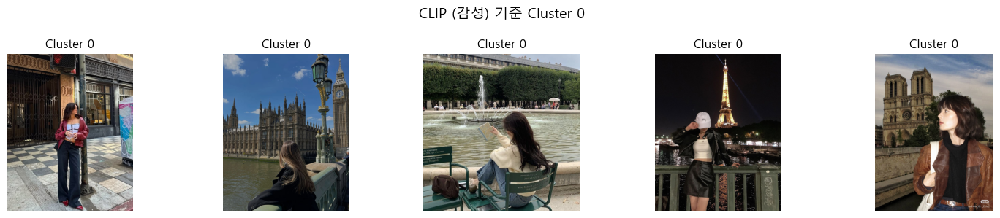


🎨 [CLIP (감성)] Cluster 1 (총 585장 중 5장 표시)


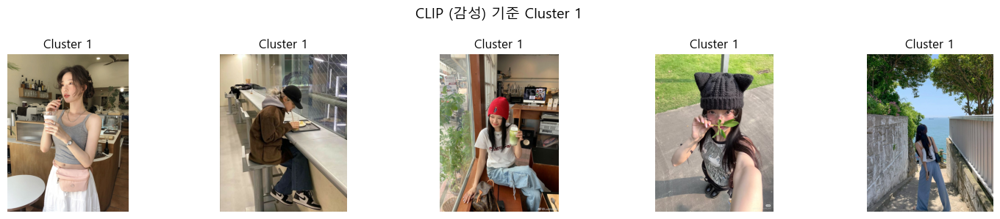


🎨 [CLIP (감성)] Cluster 2 (총 453장 중 5장 표시)


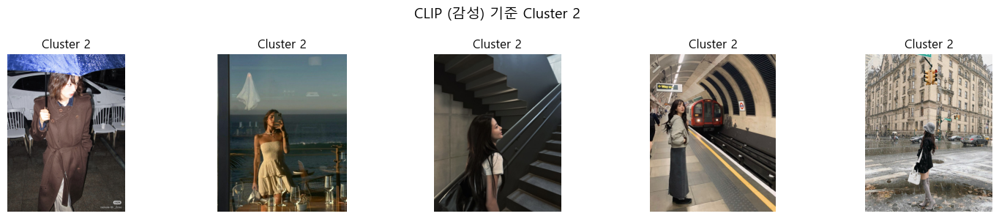


🎨 [CLIP (감성)] Cluster 3 (총 691장 중 5장 표시)


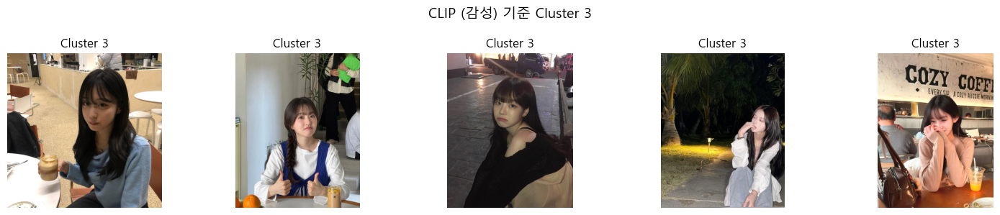


🎨 [CLIP (감성)] Cluster 4 (총 444장 중 5장 표시)


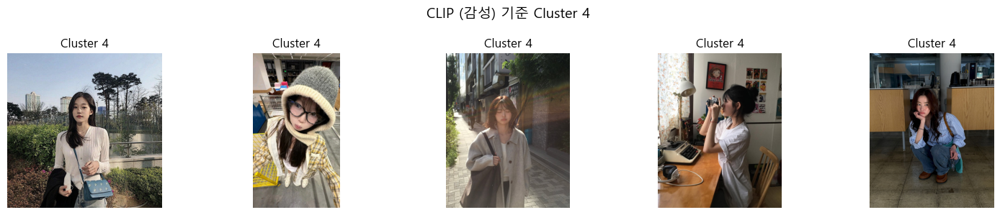


🎨 [CLIP (감성)] Cluster 5 (총 223장 중 5장 표시)


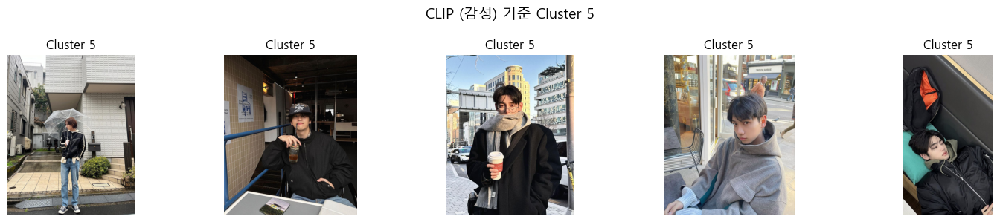


🧩 DINO (구도) 기준 군집화 중...

🎨 [DINO (구도)] Cluster 0 (총 442장 중 5장 표시)


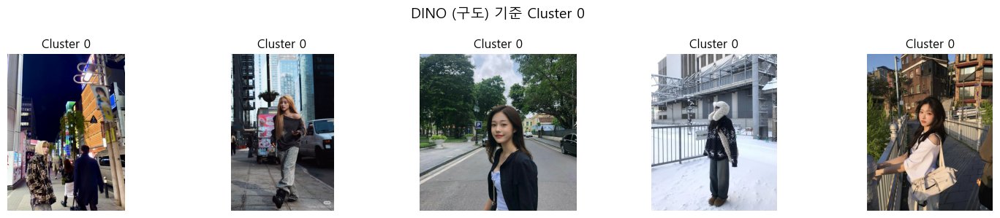


🎨 [DINO (구도)] Cluster 1 (총 338장 중 5장 표시)


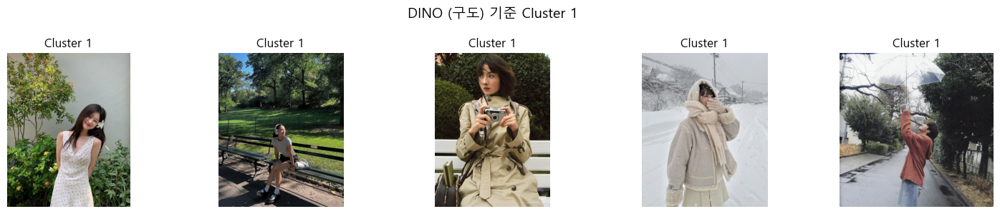


🎨 [DINO (구도)] Cluster 2 (총 293장 중 5장 표시)


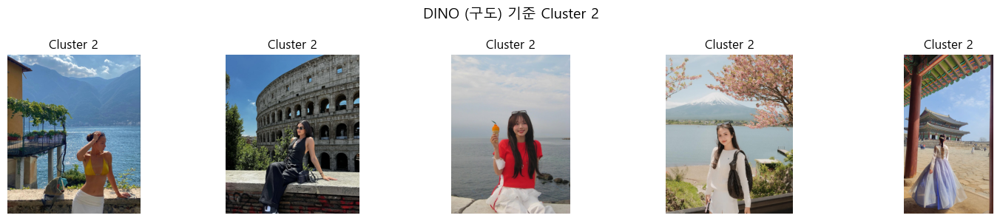


🎨 [DINO (구도)] Cluster 3 (총 450장 중 5장 표시)


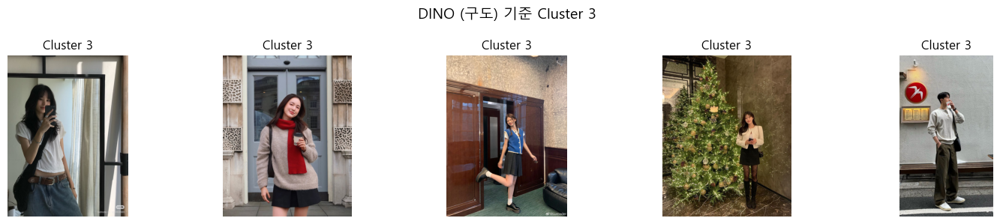


🎨 [DINO (구도)] Cluster 4 (총 762장 중 5장 표시)


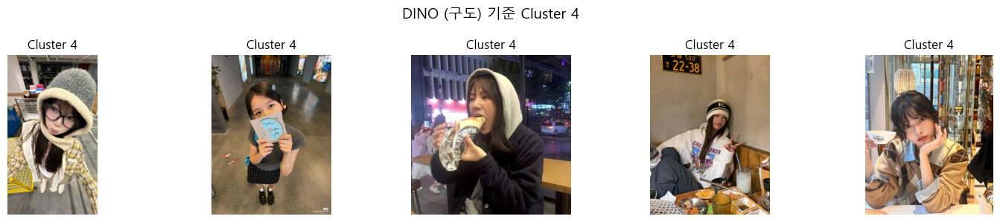


🎨 [DINO (구도)] Cluster 5 (총 402장 중 5장 표시)


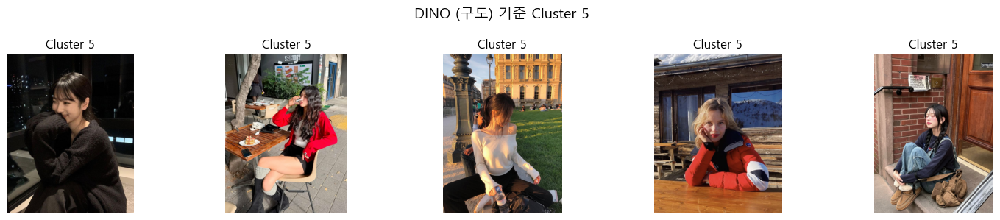


🧩 MiDaS (시점) 기준 군집화 중...

🎨 [MiDaS (시점)] Cluster 0 (총 463장 중 5장 표시)


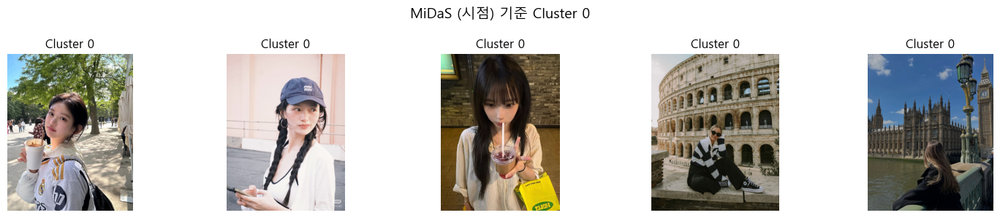


🎨 [MiDaS (시점)] Cluster 1 (총 346장 중 5장 표시)


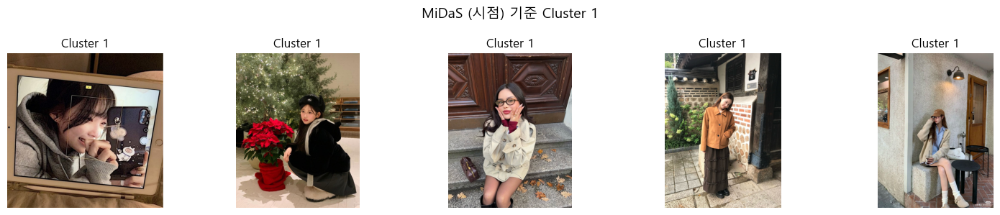


🎨 [MiDaS (시점)] Cluster 2 (총 706장 중 5장 표시)


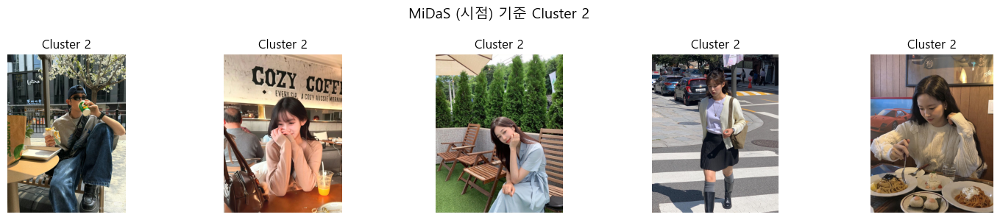


🎨 [MiDaS (시점)] Cluster 3 (총 301장 중 5장 표시)


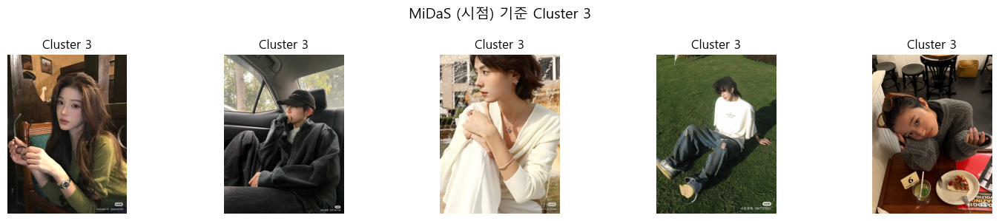


🎨 [MiDaS (시점)] Cluster 4 (총 403장 중 5장 표시)


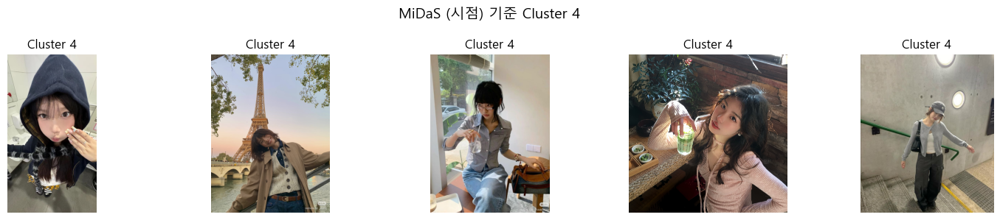


🎨 [MiDaS (시점)] Cluster 5 (총 468장 중 5장 표시)


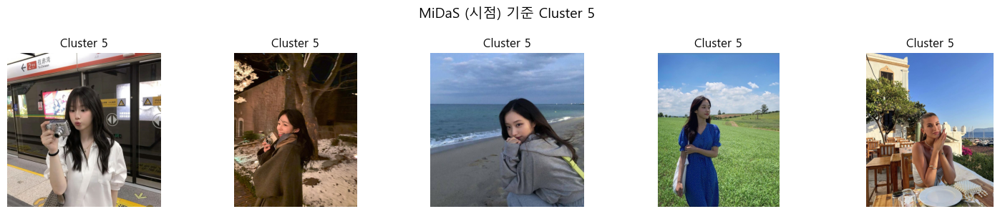

In [21]:
# ============================================================
# 📸 TryAngle Cluster Sample Viewer (CLIP / DINO / MiDaS)
# ============================================================

import polars as pl
import numpy as np
import matplotlib.pyplot as plt
import os, random, cv2
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE

# ---- 경로 설정 ----
FILE_PATH = r"C:\try_angle\features\fusion_final.parquet"
IMG_DIR = r"C:\try_angle\data\train_images"   # 원본 이미지 폴더

# ---- 데이터 로드 ----
df = pl.read_parquet(FILE_PATH)
clip_cols = [c for c in df.columns if c.startswith("clip_")]
dino_cols = [c for c in df.columns if c.startswith("dino_")]
midas_cols = [c for c in df.columns if c.startswith("midas_")]

# ---- 공통 설정 ----
n_clusters = 6
sample_n = 5

def show_cluster_samples(X, filenames, model_name):
    """주어진 feature로 KMeans 군집화 후 cluster별 이미지 시각화"""
    print(f"\n🧩 {model_name} 기준 군집화 중...")
    
    # 스케일링 + KMeans
    X_scaled = StandardScaler().fit_transform(X)
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    clusters = kmeans.fit_predict(X_scaled)
    
    df_tmp = pl.DataFrame({"filename": filenames, "cluster": clusters})
    
    for c in range(n_clusters):
        cluster_df = df_tmp.filter(pl.col("cluster") == c)
        sample_files = random.sample(list(cluster_df["filename"]), min(sample_n, len(cluster_df)))
        
        print(f"\n🎨 [{model_name}] Cluster {c} (총 {len(cluster_df)}장 중 {len(sample_files)}장 표시)")
        plt.figure(figsize=(15,3))
        
        for i, fname in enumerate(sample_files):
            fpath = os.path.join(IMG_DIR, os.path.basename(fname))
            if not os.path.exists(fpath):
                print(f"⚠️ 이미지 없음: {fpath}")
                continue
            img = cv2.imread(fpath)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            plt.subplot(1, sample_n, i+1)
            plt.imshow(img)
            plt.axis("off")
            plt.title(f"Cluster {c}")
        
        plt.suptitle(f"{model_name} 기준 Cluster {c}", fontsize=14)
        plt.tight_layout()
        plt.show()

# ---- ① CLIP ----
X_clip = df.select(clip_cols).to_numpy()
show_cluster_samples(X_clip, df["filename"].to_numpy(), "CLIP (감성)")

# ---- ② DINO ----
X_dino = df.select(dino_cols).to_numpy()
show_cluster_samples(X_dino, df["filename"].to_numpy(), "DINO (구도)")

# ---- ③ MiDaS ----
X_midas = df.select(midas_cols).to_numpy()
show_cluster_samples(X_midas, df["filename"].to_numpy(), "MiDaS (시점)")


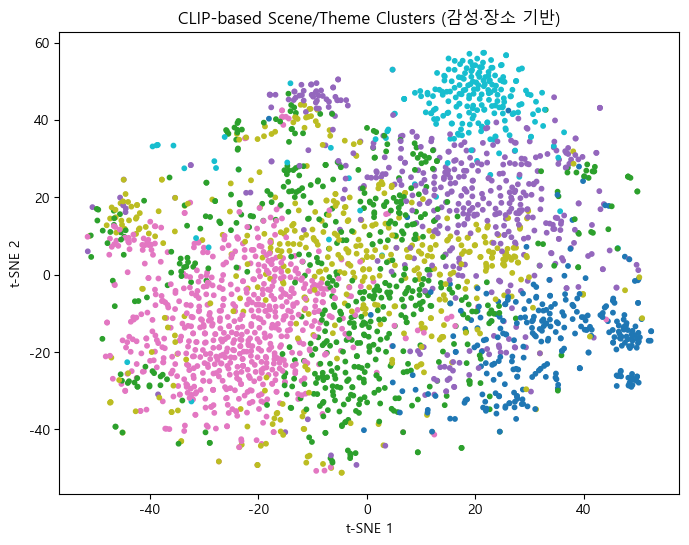

In [23]:
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import polars as pl
import numpy as np

# ✅ 데이터 로드
FILE_PATH = r"C:\try_angle\features\fusion_final.parquet"
df = pl.read_parquet(FILE_PATH)

clip_cols = [c for c in df.columns if c.startswith("clip_")]
X = df.select(clip_cols).to_numpy()

# ✅ 스케일링 & 차원축소
X_scaled = StandardScaler().fit_transform(X)
tsne = TSNE(n_components=2, random_state=42, perplexity=40, max_iter=1500)  # 수정됨!
X_emb = tsne.fit_transform(X_scaled)

# ✅ KMeans로 cluster 구분
n_clusters = 6
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
clusters = kmeans.fit_predict(X_scaled)

# ✅ 시각화
plt.figure(figsize=(8, 6))
plt.scatter(X_emb[:,0], X_emb[:,1], c=clusters, cmap='tab10', s=10)
plt.title("CLIP-based Scene/Theme Clusters (감성·장소 기반)")
plt.xlabel("t-SNE 1")
plt.ylabel("t-SNE 2")
plt.show()



🎨 Cluster 0 (표본 291장 중 10장 표시)


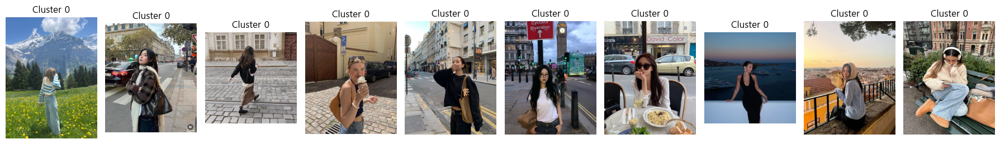


🎨 Cluster 1 (표본 585장 중 10장 표시)


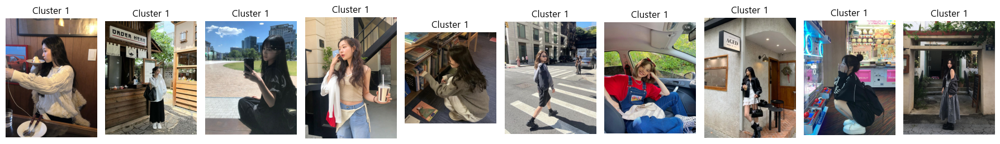


🎨 Cluster 2 (표본 453장 중 10장 표시)


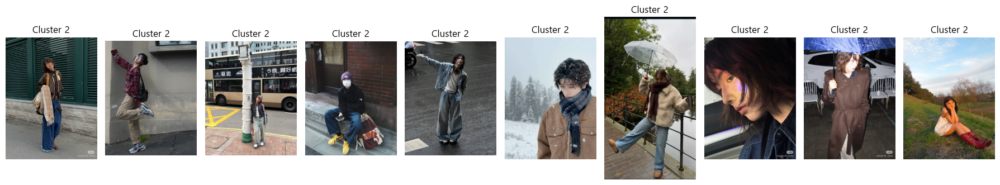


🎨 Cluster 3 (표본 691장 중 10장 표시)


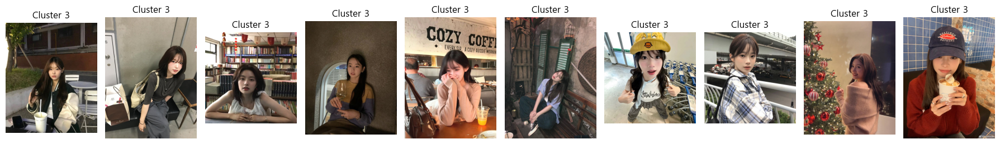


🎨 Cluster 4 (표본 444장 중 10장 표시)


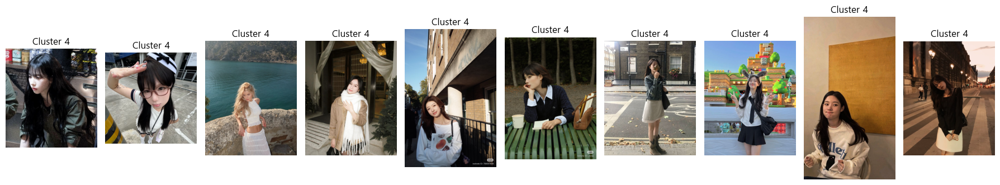


🎨 Cluster 5 (표본 223장 중 10장 표시)


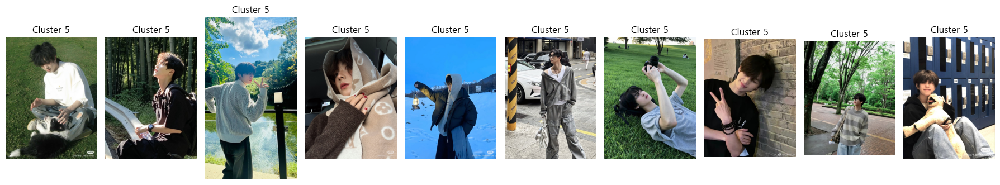

In [26]:
# ======================================================
# 📸 Cluster별 대표 이미지 시각화 (10장씩)
# ======================================================

import random, os, cv2
import matplotlib.pyplot as plt
import polars as pl

# (이미 앞에서 df, n_clusters, IMG_DIR 정의되어 있다고 가정)
# cluster 컬럼까지 포함된 상태여야 함!

os.makedirs(os.path.join(IMG_DIR, "clip_clusters"), exist_ok=True)

# 🔹 표시할 샘플 개수 조정
sample_n = 10   # ← 여기만 바꾸면 됨

for c in range(n_clusters):
    cluster_df = df.filter(pl.col("cluster") == c)
    sample_files = random.sample(list(cluster_df["filename"]), min(sample_n, len(cluster_df)))
    print(f"\n🎨 Cluster {c} (표본 {len(cluster_df)}장 중 {len(sample_files)}장 표시)")

    plt.figure(figsize=(18, 4))
    for i, fname in enumerate(sample_files):
        fpath = os.path.join(IMG_DIR, os.path.basename(fname))
        if not os.path.exists(fpath):
            print(f"⚠️ 이미지 없음: {fpath}")
            continue
        img = cv2.imread(fpath)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.subplot(1, sample_n, i+1)
        plt.imshow(img)
        plt.axis("off")
        plt.title(f"Cluster {c}")
    plt.tight_layout()
    plt.show()




In [27]:
from sklearn.metrics import silhouette_score, davies_bouldin_score

# KMeans 결과 기반
sil_score = silhouette_score(X_scaled, clusters)
dbi_score = davies_bouldin_score(X_scaled, clusters)

print(f"🧩 Silhouette Score: {sil_score:.3f}")
print(f"📉 Davies–Bouldin Index: {dbi_score:.3f}")


🧩 Silhouette Score: 0.031
📉 Davies–Bouldin Index: 4.375


In [28]:
import torch
import clip
from PIL import Image
from sklearn.preprocessing import normalize

device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)

# cluster 중심 계산
centers = []
for c in range(n_clusters):
    cluster_feats = X_scaled[clusters == c]
    centers.append(cluster_feats.mean(axis=0))
centers = np.vstack(centers)

# 텍스트 후보들
text_labels = ["a cozy cafe", "a snowy landscape", "a beach vacation", 
               "a night city street", "a forest park", "an indoor portrait"]
text_tokens = clip.tokenize(text_labels).to(device)

with torch.no_grad():
    text_emb = model.encode_text(text_tokens)
text_emb = normalize(text_emb.cpu().numpy())

# 각 cluster 중심과 텍스트 간 유사도 계산
sim = np.dot(centers, text_emb.T)
for i in range(n_clusters):
    best = np.argmax(sim[i])
    print(f"Cluster {i} → '{text_labels[best]}' (유사도: {sim[i][best]:.3f})")


Cluster 0 → 'a night city street' (유사도: 0.817)
Cluster 1 → 'a cozy cafe' (유사도: 0.326)
Cluster 2 → 'a forest park' (유사도: 1.042)
Cluster 3 → 'a cozy cafe' (유사도: -0.268)
Cluster 4 → 'an indoor portrait' (유사도: 0.229)
Cluster 5 → 'a beach vacation' (유사도: -0.205)


In [29]:
# ======================================================
#  CLIP:DINO:MiDaS = 0.3:0.3:0.4 가중합 평가
# ======================================================
import polars as pl
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score

FILE_PATH = r"C:\try_angle\features\fusion_final.parquet"
df = pl.read_parquet(FILE_PATH)

# 🔹 feature 분리
clip = df.select([c for c in df.columns if c.startswith("clip_")]).to_numpy()
dino = df.select([c for c in df.columns if c.startswith("dino_")]).to_numpy()
midas = df.select(["midas_mean", "midas_std"]).to_numpy()

# 🔹 정규화 + 차원축소
scaler = StandardScaler()
clip_z = scaler.fit_transform(clip)
dino_z = scaler.fit_transform(dino)
midas_z = scaler.fit_transform(midas)

clip_pca = PCA(n_components=128, random_state=42).fit_transform(clip_z)
dino_pca = PCA(n_components=128, random_state=42).fit_transform(dino_z)

# 🔹 가중합 (0.3, 0.3, 0.4)
α, β, γ = 0.3, 0.3, 0.4
fusion = np.hstack([
    α * clip_pca,
    β * dino_pca,
    γ * midas_z
])
fusion = StandardScaler().fit_transform(fusion)

# 🔹 군집화 (k=6 정도부터 테스트)
best_sil = -1
best_k = None
for k in range(5, 11):
    km = KMeans(n_clusters=k, random_state=42, n_init="auto")
    labels = km.fit_predict(fusion)
    sil = silhouette_score(fusion, labels)
    dbi = davies_bouldin_score(fusion, labels)
    print(f"k={k} → Silhouette={sil:.3f}, DBI={dbi:.3f}")
    if sil > best_sil:
        best_sil, best_k = sil, k

print("\n✅ 최적 k값:", best_k)
print(f"🧩 최고 Silhouette Score: {best_sil:.3f}")

# 🔹 최적 k로 최종 클러스터링
km_final = KMeans(n_clusters=best_k, random_state=42, n_init="auto")
df = df.with_columns(pl.Series("cluster", km_final.fit_predict(fusion)))

print("\n📁 cluster 컬럼 추가 완료 → df.columns 마지막 확인!")
print(df.columns[-5:])


k=5 → Silhouette=-0.010, DBI=7.967
k=6 → Silhouette=-0.010, DBI=7.685
k=7 → Silhouette=-0.004, DBI=7.382
k=8 → Silhouette=-0.009, DBI=7.442
k=9 → Silhouette=-0.010, DBI=7.150
k=10 → Silhouette=-0.002, DBI=6.914

✅ 최적 k값: 10
🧩 최고 Silhouette Score: -0.002

📁 cluster 컬럼 추가 완료 → df.columns 마지막 확인!
['dino_382', 'dino_383', 'midas_mean', 'midas_std', 'cluster']


In [30]:
# ======================================================
#  CLIP:DINO:MiDaS = 0.4:0.3:0.3 가중합 평가
# ======================================================
import polars as pl
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score

FILE_PATH = r"C:\try_angle\features\fusion_final.parquet"
df = pl.read_parquet(FILE_PATH)

# 🔹 feature 분리
clip = df.select([c for c in df.columns if c.startswith("clip_")]).to_numpy()
dino = df.select([c for c in df.columns if c.startswith("dino_")]).to_numpy()
midas = df.select(["midas_mean", "midas_std"]).to_numpy()

# 🔹 정규화 + 차원축소
scaler = StandardScaler()
clip_z = scaler.fit_transform(clip)
dino_z = scaler.fit_transform(dino)
midas_z = scaler.fit_transform(midas)

clip_pca = PCA(n_components=128, random_state=42).fit_transform(clip_z)
dino_pca = PCA(n_components=128, random_state=42).fit_transform(dino_z)

# 🔹 가중합 (0.4, 0.3, 0.3)
α, β, γ = 0.4, 0.3, 0.3
fusion = np.hstack([
    α * clip_pca,
    β * dino_pca,
    γ * midas_z
])
fusion = StandardScaler().fit_transform(fusion)

# 🔹 군집화 (k=5~10 테스트)
best_sil = -1
best_k = None
for k in range(5, 11):
    km = KMeans(n_clusters=k, random_state=42, n_init="auto")
    labels = km.fit_predict(fusion)
    sil = silhouette_score(fusion, labels)
    dbi = davies_bouldin_score(fusion, labels)
    print(f"k={k} → Silhouette={sil:.3f}, DBI={dbi:.3f}")
    if sil > best_sil:
        best_sil, best_k = sil, k

print("\n✅ 최적 k값:", best_k)
print(f"🧩 최고 Silhouette Score: {best_sil:.3f}")

# 🔹 최적 k로 클러스터링 후 저장
km_final = KMeans(n_clusters=best_k, random_state=42, n_init="auto")
df = df.with_columns(pl.Series("cluster", km_final.fit_predict(fusion)))

print("\n📁 cluster 컬럼 추가 완료 → df.columns 마지막 확인!")
print(df.columns[-5:])


k=5 → Silhouette=-0.010, DBI=7.967
k=6 → Silhouette=-0.010, DBI=7.685
k=7 → Silhouette=-0.004, DBI=7.382
k=8 → Silhouette=-0.009, DBI=7.442
k=9 → Silhouette=-0.010, DBI=7.150
k=10 → Silhouette=-0.002, DBI=6.914

✅ 최적 k값: 10
🧩 최고 Silhouette Score: -0.002

📁 cluster 컬럼 추가 완료 → df.columns 마지막 확인!
['dino_382', 'dino_383', 'midas_mean', 'midas_std', 'cluster']


In [31]:
# ======================================================
# CLIP만으로 감성(테마/장소) 군집화
# ======================================================
import polars as pl
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score

FILE_PATH = r"C:\try_angle\features\fusion_final.parquet"
df = pl.read_parquet(FILE_PATH)

# 🔹 CLIP feature만 사용
clip = df.select([c for c in df.columns if c.startswith("clip_")]).to_numpy()

# 🔹 표준화 + 차원축소
clip_z = StandardScaler().fit_transform(clip)
clip_pca = PCA(n_components=128, random_state=42).fit_transform(clip_z)

# 🔹 k값 탐색
best_sil = -1
best_k = None
for k in range(4, 11):
    km = KMeans(n_clusters=k, random_state=42, n_init="auto")
    labels = km.fit_predict(clip_pca)
    sil = silhouette_score(clip_pca, labels)
    dbi = davies_bouldin_score(clip_pca, labels)
    print(f"k={k} → Silhouette={sil:.3f}, DBI={dbi:.3f}")
    if sil > best_sil:
        best_sil, best_k = sil, k

print("\n✅ 최적 k값:", best_k)
print(f"🧩 최고 Silhouette Score: {best_sil:.3f}")

# 🔹 최적 k로 최종 군집화
km_final = KMeans(n_clusters=best_k, random_state=42, n_init="auto")
df = df.with_columns(pl.Series("cluster", km_final.fit_predict(clip_pca)))

print("\n📁 cluster 컬럼 추가 완료 → df.columns 마지막 확인!")
print(df.columns[-5:])


k=4 → Silhouette=0.055, DBI=3.869
k=5 → Silhouette=0.037, DBI=4.024
k=6 → Silhouette=0.038, DBI=3.970
k=7 → Silhouette=0.032, DBI=4.073
k=8 → Silhouette=0.031, DBI=3.947
k=9 → Silhouette=0.030, DBI=4.043
k=10 → Silhouette=0.029, DBI=4.038

✅ 최적 k값: 4
🧩 최고 Silhouette Score: 0.055

📁 cluster 컬럼 추가 완료 → df.columns 마지막 확인!
['dino_382', 'dino_383', 'midas_mean', 'midas_std', 'cluster']



🎨 Cluster 0 (총 614장 중 10장 표시)


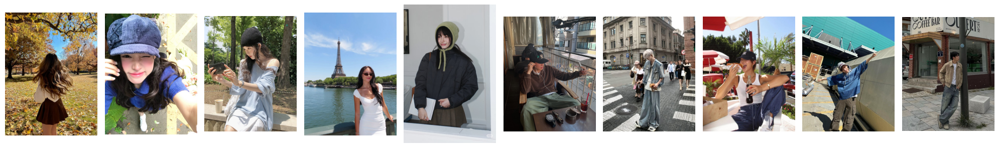


🎨 Cluster 1 (총 247장 중 10장 표시)


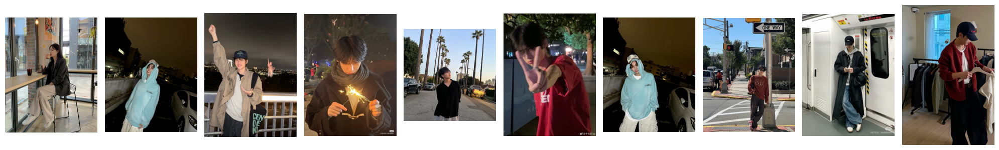


🎨 Cluster 2 (총 853장 중 10장 표시)


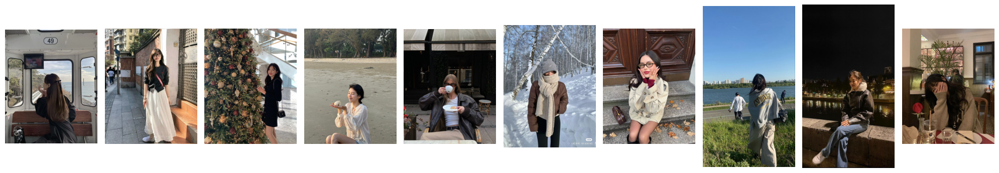


🎨 Cluster 3 (총 973장 중 10장 표시)


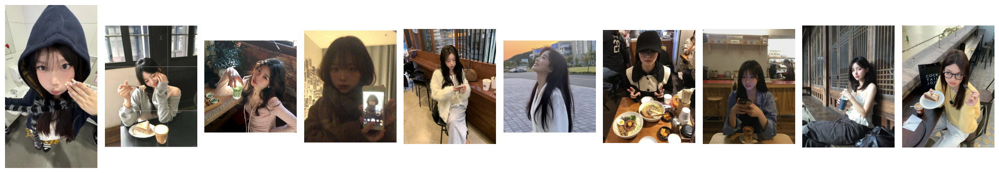

In [32]:
# ======================================================
# cluster별 대표 이미지 10장씩 보기
# ======================================================
import random, os, cv2
import matplotlib.pyplot as plt

IMG_DIR = r"C:\try_angle\data\train_images"  # 실제 이미지 폴더 경로
sample_n = 10

for c in sorted(df["cluster"].unique()):
    cluster_df = df.filter(pl.col("cluster") == c)
    sample_files = random.sample(list(cluster_df["filename"]), min(sample_n, len(cluster_df)))

    print(f"\n🎨 Cluster {c} (총 {len(cluster_df)}장 중 {len(sample_files)}장 표시)")
    plt.figure(figsize=(20, 4))
    for i, fname in enumerate(sample_files):
        fpath = os.path.join(IMG_DIR, os.path.basename(fname))
        if not os.path.exists(fpath):
            continue
        img = cv2.imread(fpath)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.subplot(1, sample_n, i+1)
        plt.imshow(img)
        plt.axis("off")
    plt.tight_layout()
    plt.show()


In [ ]:
# ======================================================
# 📸 TryAngle - CLIP 기반 테마 클러스터링 자동화
# ======================================================
import os, random, cv2, torch, clip
import numpy as np
import matplotlib.pyplot as plt
import polars as pl
from sklearn.preprocessing import StandardScaler, normalize
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score

# ------------------------------------------------------
# [1] 파일 경로 설정
# ------------------------------------------------------
FILE_PATH = r"C:\try_angle\features\fusion_final.parquet"
IMG_DIR   = r"C:\try_angle\data\train_images"
SAVE_PATH = r"C:\try_angle\features\fusion_final_with_cluster.parquet"

# ------------------------------------------------------
# [2] 데이터 로드 + CLIP feature 추출
# ------------------------------------------------------
print("📂 데이터 로드 중...")
df = pl.read_parquet(FILE_PATH)
clip_feats = df.select([c for c in df.columns if c.startswith("clip_")]).to_numpy()

# ------------------------------------------------------
# [3] CLIP 기반 군집화
# ------------------------------------------------------
print("🧠 CLIP 기반 KMeans 군집화 실행 중...")

clip_z = StandardScaler().fit_transform(clip_feats)
clip_pca = PCA(n_components=128, random_state=42).fit_transform(clip_z)

best_sil, best_k = -1, None
for k in range(4, 11):
    km = KMeans(n_clusters=k, random_state=42, n_init="auto")
    labels = km.fit_predict(clip_pca)
    sil = silhouette_score(clip_pca, labels)
    dbi = davies_bouldin_score(clip_pca, labels)
    print(f"k={k} → Silhouette={sil:.3f}, DBI={dbi:.3f}")
    if sil > best_sil:
        best_sil, best_k = sil, k

print(f"\n✅ 최적 k값: {best_k} | 🧩 Silhouette Score: {best_sil:.3f}")

# 최종 모델 학습
km_final = KMeans(n_clusters=best_k, random_state=42, n_init="auto")
cluster_labels = km_final.fit_predict(clip_pca)
df = df.with_columns(pl.Series("cluster", cluster_labels))

# 저장
df.write_parquet(SAVE_PATH)
print(f"💾 클러스터 컬럼 포함 저장 완료 → {SAVE_PATH}")

# ------------------------------------------------------
# [4] CLIP으로 cluster별 의미(테마) 자동 태깅
# ------------------------------------------------------
print("\n🔎 CLIP으로 cluster별 테마 자동 인식 중...")

device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)

cluster_ids = sorted(df["cluster"].unique())
centers = []
for c in cluster_ids:
    # ✅ PCA 말고 원본 CLIP feature(512차원)로 중심 계산
    cluster_feats = clip_feats[df["cluster"].to_numpy() == c]
    centers.append(cluster_feats.mean(axis=0))
centers = np.vstack(centers)
centers = normalize(centers)

# 비교할 테마 후보 문장
text_labels = [
    "a cozy cafe", "a snowy landscape", "a beach vacation", "a city street",
    "a mountain hiking trail", "a sunset photo", "an indoor portrait", "a forest park"
]
text_tokens = clip.tokenize(text_labels).to(device)
with torch.no_grad():
    text_emb = model.encode_text(text_tokens)
text_emb = normalize(text_emb.cpu().numpy())

# ✅ 유사도 계산 (512x512 맞음)
sim = np.dot(centers, text_emb.T)

# ✅ 자동 태깅
auto_labels = []
print("\n=== 🏷️ Cluster 자동 태깅 결과 ===")
for i, c in enumerate(cluster_ids):
    best = np.argmax(sim[i])
    label = text_labels[best]
    score = sim[i][best]
    auto_labels.append(label)
    print(f"Cluster {c} → '{label}' (유사도: {score:.3f})")

# ------------------------------------------------------
# [5] cluster별 대표 이미지 시각화
# ------------------------------------------------------
print("\n🖼️ Cluster별 대표 이미지 표시 중...\n")

sample_n = 10
for c, label in zip(cluster_ids, auto_labels):
    cluster_df = df.filter(pl.col("cluster") == c)
    sample_files = random.sample(list(cluster_df["filename"]), min(sample_n, len(cluster_df)))

    print(f"\n🎨 Cluster {c} ({label}) — 총 {len(cluster_df)}장 중 {len(sample_files)}장 표시")
    plt.figure(figsize=(22, 4))
    for i, fname in enumerate(sample_files):
        fpath = os.path.join(IMG_DIR, os.path.basename(fname))
        if not os.path.exists(fpath):
            continue
        img = cv2.imread(fpath)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.subplot(1, sample_n, i+1)
        plt.imshow(img)
        plt.axis("off")
        plt.title(f"{label[:15]}...", fontsize=10)
    plt.tight_layout()
    plt.show()

print("\n✅ 전체 완료! — 각 클러스터가 어떤 테마(장소/감성)인지 시각적으로 확인해보세요.")


📂 데이터 로드 중...
🧠 CLIP 기반 KMeans 군집화 실행 중...
k=4 → Silhouette=0.055, DBI=3.869
k=5 → Silhouette=0.037, DBI=4.024
k=6 → Silhouette=0.038, DBI=3.970
k=7 → Silhouette=0.032, DBI=4.073
k=8 → Silhouette=0.031, DBI=3.947
k=9 → Silhouette=0.030, DBI=4.043
k=10 → Silhouette=0.029, DBI=4.038

✅ 최적 k값: 4 | 🧩 Silhouette Score: 0.055
💾 클러스터 컬럼 포함 저장 완료 → C:\try_angle\features\fusion_final_with_cluster.parquet

🔎 CLIP으로 cluster별 테마 자동 인식 중...

🖼️ Cluster별 대표 이미지 표시 중...



NameError: name 'auto_labels' is not defined

In [1]:
# ======================================================
# 🧠 TryAngle Ultra-Advanced Clustering v2
# (PCA 제거 + UMAP 차원 축소 + 앙상블)
# ======================================================

import os, random, gc, warnings
import numpy as np
import polars as pl
import matplotlib.pyplot as plt
import cv2
from scipy.stats import skew, kurtosis, mode
from scipy.cluster.hierarchy import linkage, fcluster
from scipy.spatial.distance import cdist
from skimage.feature import local_binary_pattern

from sklearn.preprocessing import RobustScaler, normalize
from sklearn.cluster import KMeans, SpectralClustering
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score

import hdbscan
from umap import UMAP

warnings.filterwarnings('ignore')

# [1] 경로 설정
PARQUET_PATH = r"C:\try_angle\features\fusion_final_with_openclip.parquet"
IMG_DIR = r"C:\try_angle\data\train_images"

# [2] 색상/텍스처 특징 추출 함수
def extract_color_texture_features(img_path):
    """색상 히스토그램 + 텍스처 특징 (119차원)"""
    try:
        img = cv2.imread(img_path)
        if img is None:
            return None
        
        img = cv2.resize(img, (256, 256))
        img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        img_lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        
        features = []
        
        # HSV 히스토그램
        for channel in cv2.split(img_hsv):
            hist = cv2.calcHist([channel], [0], None, [32], [0, 256]).flatten()
            hist = hist / (hist.sum() + 1e-7)
            features.extend(hist)
        
        # LAB 통계
        for channel in cv2.split(img_lab):
            flat = channel.flatten()
            features.extend([flat.mean(), flat.std(), skew(flat), kurtosis(flat)])
        
        # LBP 텍스처
        lbp = local_binary_pattern(gray, P=8, R=1, method='uniform')
        lbp_hist, _ = np.histogram(lbp.ravel(), bins=10, range=(0, 10))
        lbp_hist = lbp_hist / (lbp_hist.sum() + 1e-7)
        features.extend(lbp_hist)
        
        # 엣지 밀도
        edges = cv2.Canny(gray, 50, 150)
        edge_density = edges.sum() / edges.size
        features.append(edge_density)
        
        return np.array(features, dtype=np.float32)
    except Exception as e:
        print(f"[❌] 특징 추출 실패: {e}")
        return None

# [3] 데이터 로드
print("📂 데이터 로드 중...")
df = pl.read_parquet(PARQUET_PATH)

clip_feats = df.select([c for c in df.columns if c.startswith("clip_")]).to_numpy()
openclip_feats = df.select([c for c in df.columns if c.startswith("openclip_")]).to_numpy()
dino_feats = df.select([c for c in df.columns if c.startswith("dino_")]).to_numpy()
midas_mean = df.select("midas_mean").to_numpy().flatten()
midas_std = df.select("midas_std").to_numpy().flatten()
filenames = df.select("filename").to_series().to_list()

print(f"✅ 기존 특징 로드 완료")

# [4] 색상/텍스처 특징 추출
print("\n🎨 색상/텍스처 특징 추출 중...")
color_texture_list = []
for fname in filenames:
    fpath = os.path.join(IMG_DIR, os.path.basename(fname))
    feat = extract_color_texture_features(fpath)
    if feat is None:
        feat = np.zeros(119, dtype=np.float32)
    color_texture_list.append(feat)

color_texture_feats = np.array(color_texture_list)
print(f"✅ 색상/텍스처 특징: {color_texture_feats.shape}")

# [5] 정규화 (PCA 제거)
print("\n🔹 특징 정규화 중 (PCA 제거)...")
scaler = RobustScaler()

clip_z = scaler.fit_transform(clip_feats)
openclip_z = scaler.fit_transform(openclip_feats)
dino_z = scaler.fit_transform(dino_feats)
color_z = scaler.fit_transform(color_texture_feats)

midas_feats = np.column_stack([midas_mean, midas_std])
midas_z = scaler.fit_transform(midas_feats)

# [6] 전체 특징 Concat + 가중치
w_clip, w_openclip, w_dino, w_color, w_midas = 0.30, 0.30, 0.25, 0.12, 0.03

clip_weighted = clip_z * w_clip
openclip_weighted = openclip_z * w_openclip
dino_weighted = dino_z * w_dino
color_weighted = color_z * w_color
midas_weighted = midas_z * w_midas

fusion_raw = np.concatenate([
    clip_weighted, openclip_weighted, dino_weighted, color_weighted, midas_weighted
], axis=1)

print(f"✅ 원본 융합 특징: {fusion_raw.shape}")

# [7] UMAP 차원 축소 (128차원)
print("\n🔹 UMAP 차원 축소 중 (128차원)...")
umap_high = UMAP(
    n_components=128,
    n_neighbors=30,
    min_dist=0.0,
    metric='cosine',
    random_state=42,
    verbose=True
)
fusion = umap_high.fit_transform(fusion_raw)
fusion = normalize(fusion, norm='l2')

print(f"✅ UMAP 축소 완료: {fusion.shape}")

# [8] UMAP 2D 시각화용
print("\n🔹 UMAP 2D 시각화용 임베딩 생성 중...")
umap_2d = UMAP(n_components=2, n_neighbors=30, min_dist=0.0, 
               metric='cosine', random_state=42).fit_transform(fusion)

# [9] 앙상블 클러스터링
print("\n🔹 앙상블 클러스터링 중...")
k_target = 10

# KMeans
km = KMeans(n_clusters=k_target, random_state=42, n_init=10, max_iter=300)
labels_km = km.fit_predict(fusion)

# Hierarchical
Z = linkage(fusion, method='ward', metric='euclidean')
labels_hier = fcluster(Z, t=k_target, criterion='maxclust') - 1

# GMM
gmm = GaussianMixture(n_components=k_target, covariance_type='full', 
                      random_state=42, max_iter=200)
labels_gmm = gmm.fit_predict(fusion)

# Spectral
spec = SpectralClustering(n_clusters=k_target, affinity='nearest_neighbors', 
                          n_neighbors=50, random_state=42, n_jobs=-1)
labels_spec = spec.fit_predict(fusion)

# 앙상블 투표
label_matrix = np.stack([labels_km, labels_hier, labels_gmm, labels_spec], axis=0)
ensemble_labels, _ = mode(label_matrix, axis=0)
ensemble_labels = ensemble_labels.flatten()

# [10] 성능 비교
algorithms = {
    'KMeans': labels_km,
    'Hierarchical': labels_hier,
    'GMM': labels_gmm,
    'Spectral': labels_spec,
    'Ensemble': ensemble_labels
}

best_sil = -1
best_method = None
best_labels = None

for name, labels in algorithms.items():
    sil = silhouette_score(fusion, labels, sample_size=min(5000, len(fusion)))
    dbi = davies_bouldin_score(fusion, labels)
    chi = calinski_harabasz_score(fusion, labels)
    
    print(f"  {name:15s} → Sil={sil:.4f} | DBI={dbi:.3f} | CH={chi:.1f}")
    
    if sil > best_sil:
        best_sil = sil
        best_method = name
        best_labels = labels

print(f"\n🏆 최고 성능: {best_method} (Silhouette={best_sil:.4f})")

# DataFrame에 추가
df = df.with_columns(pl.Series("cluster", best_labels))

# [11] 결과 저장
output_path = r"C:\try_angle\features\clustered_umap_v2_result.parquet"
df.write_parquet(output_path, compression='snappy')

print(f"\n✅ 전체 클러스터링 완료!")
print(f"🎯 최종 성능: Silhouette={best_sil:.4f}")

c:\Users\HS\anaconda3\envs\TA\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


📂 데이터 로드 중...
✅ 기존 특징 로드 완료

🎨 색상/텍스처 특징 추출 중...
✅ 색상/텍스처 특징: (2687, 119)

🔹 특징 정규화 중 (PCA 제거)...
✅ 원본 융합 특징: (2687, 1529)

🔹 UMAP 차원 축소 중 (128차원)...
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.0, n_components=128, n_jobs=1, n_neighbors=30, random_state=42, verbose=True)
Thu Nov 13 14:27:56 2025 Construct fuzzy simplicial set
Thu Nov 13 14:28:05 2025 Finding Nearest Neighbors
Thu Nov 13 14:28:09 2025 Finished Nearest Neighbor Search
Thu Nov 13 14:28:10 2025 Construct embedding


Epochs completed:   3%| ▎          13/500 [00:00]

	completed  0  /  500 epochs


Epochs completed:  13%| █▎         63/500 [00:01]

	completed  50  /  500 epochs


Epochs completed:  23%| ██▎        113/500 [00:01]

	completed  100  /  500 epochs


Epochs completed:  33%| ███▎       163/500 [00:02]

	completed  150  /  500 epochs


Epochs completed:  43%| ████▎      213/500 [00:02]

	completed  200  /  500 epochs


Epochs completed:  53%| █████▎     263/500 [00:03]

	completed  250  /  500 epochs


Epochs completed:  63%| ██████▎    313/500 [00:03]

	completed  300  /  500 epochs


Epochs completed:  73%| ███████▎   363/500 [00:04]

	completed  350  /  500 epochs


Epochs completed:  85%| ████████▍  423/500 [00:04]

	completed  400  /  500 epochs


Epochs completed:  95%| █████████▍ 473/500 [00:05]

	completed  450  /  500 epochs


Epochs completed: 100%| ██████████ 500/500 [00:05]


Thu Nov 13 14:28:17 2025 Finished embedding
✅ UMAP 축소 완료: (2687, 128)

🔹 UMAP 2D 시각화용 임베딩 생성 중...

🔹 앙상블 클러스터링 중...
  KMeans          → Sil=0.4204 | DBI=0.891 | CH=2197.4
  Hierarchical    → Sil=0.3999 | DBI=0.929 | CH=2044.4
  GMM             → Sil=0.3530 | DBI=1.017 | CH=1966.1
  Spectral        → Sil=0.3747 | DBI=0.867 | CH=1873.5
  Ensemble        → Sil=0.0367 | DBI=1.479 | CH=306.1

🏆 최고 성능: KMeans (Silhouette=0.4204)

✅ 전체 클러스터링 완료!
🎯 최종 성능: Silhouette=0.4204
